In [16]:
# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

In [17]:
import urbanpy as up
import pandas as pd
import geopandas as gpd
import numpy as np
import contextily as cx
import plotly
import plotly.express as px
import matplotlib.pyplot as plt
import time
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from matplotlib.lines import Line2D
from tqdm.auto import tqdm
from pandarallel import pandarallel

import os

os.environ['JOBLIB_TEMP_FOLDER'] = '/tmp' 
pandarallel.initialize(nb_workers=30,progress_bar=True,verbose=2,use_memory_fs = False ) 

INFO: Pandarallel will run on 30 workers.
INFO: Pandarallel will use standard multiprocessing data transfer (pipe) to transfer data between the main process and workers.


In [18]:
tqdm.pandas() # Activate progress bar for pandas apply

## Download population data

You can see the data/metadata in HDX UI [here](https://data.humdata.org/dataset/brazil-high-resolution-population-density-maps-demographic-estimates).

We get the population data at the *country* level from a function in `urbanpy`.  First, list the country, then the type of population:

- `full`: entire population **this argument does not work, needs to be hard coded**
- `children`: children (age 0-5)
- `youth`: youth (15-24)
- `elderly`: Ages 60+

So let's start by getting Brazil population data.  As discussed in this [issue](https://github.com/EL-BID/urbanpy/issues/19), the population data gets moved sometimes so we need to hard code links to the full demographic data.

But if you want segments of the population for all of Brazil, that can be done through built in functions.

Look for brazil's population data here: https://data.humdata.org/dataset/brazil-high-resolution-population-density-maps-demographic-estimates

In [19]:
# Download country populations
full_pop_brazil_southeast = up.download.hdx_dataset(resource="c17003d1-47f4-4ec5-8229-2f77aeb114be/resource/eb17516f-3c84-4626-95e4-df1f342f3d82/download/population_bra_southeast_2018-10-01.csv.zip")
full_pop_brazil_northeast = up.download.hdx_dataset(resource="c17003d1-47f4-4ec5-8229-2f77aeb114be/resource/957218ee-c740-44c0-88e5-7faeef813a0c/download/population_bra_northeast_2018-10-01.csv.zip")
full_pop_brazil_northwest = up.download.hdx_dataset(resource="c17003d1-47f4-4ec5-8229-2f77aeb114be/resource/1e1f271b-1055-4365-b391-f6fdf3093fe2/download/population_bra_northwest_2018-10-01.csv.zip")

In [20]:
# Population parameters
pop_col="population"

In [21]:
# General parameters
hex_res=7
poi_type='education'
education_poi_includes=['school', 'kindergarten', 'language_school', 'library']
osrm_server={"country":"sudeste", "continent":"south-america_brazil"}

In [22]:
def accessibility_analysis(hexagons, pois):
    # Calculate the Nearest Facility for each Hexagon
    hexagons['lon'] = hexagons.geometry.centroid.x
    hexagons['lat'] = hexagons.geometry.centroid.y
    
    dists, ixs = up.utils.nn_search(
        tree_features=pois[['lat', 'lon']].values,
        query_features=hexagons[['lat', 'lon']].values,
        metric='haversine'
    )
    
    hexagons["nearest_poi_ix"] = ixs
    
    # Calculate travel times and distances
    distance_duration = hexagons.progress_apply(
        lambda row: up.routing.osrm_route(
            origin=row.geometry.centroid, 
            destination = pois.iloc[row['nearest_poi_ix']]['geometry']
        ),
        result_type='expand',
        axis=1,
    )
    
    # Add columns to dataframe
    hexagons['distance_to_nearest_poi'] =  distance_duration[0] / 1000 # meters to km
    hexagons['duration_to_nearest_poi'] = distance_duration[1] / 60 # seconds to minutes
    
    custom_bins, custom_labels = up.utils.create_duration_labels(hexagons['duration_to_nearest_poi'])
    hexagons['duration_to_nearest_poi_label'] = pd.cut(hexagons['duration_to_nearest_poi'], bins=custom_bins, labels=custom_labels)
        
    return hexagons

In [23]:
def gen_map(city_str, pop_df, pop_col, hex_res, poi_type, osrm_server, city_id=0):
    city = up.download.nominatim_osm(city_str, city_id)
    city.plot()
    plt.show()
    
    hexs_city = up.geom.gen_hexagons(resolution=hex_res, city=city)
    print("hex num:", hexs_city.shape[0])
    
    city_pop = up.geom.filter_population(pop_df, city)
    hexs_city_pop = up.geom.merge_shape_hex(hexs_city, city_pop, agg={pop_col: "sum"})
    
    city_hf = up.download.overpass_pois(city.total_bounds, poi_type)
    if poi_type == 'education':
        city_hf = city_hf[city_hf['poi_type'].isin(education_poi_includes)]
    print("poi:", city_hf.poi_type.value_counts())
    
    up.routing.start_osrm_server(osrm_server["country"], osrm_server["continent"], "foot")
    time.sleep(20) # Big server
    
    for i in range(5):
        try:
            hexs_city_pop_access = accessibility_analysis(hexagons=hexs_city_pop, pois=city_hf)
            
            up.routing.stop_osrm_server(osrm_server["country"], osrm_server["continent"], "foot")
            
            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            divider = make_axes_locatable(ax)
            cax = divider.append_axes("right", size="5%", pad=0.1)
            hexs_city_pop_access.query(f"{pop_col} > 0").plot(f"{pop_col}", alpha=0.5, legend=True, cax=cax, ax=ax)
            ax.set_title(f'Population \nat H3 hexagons resolution {hex_res}')
            ax.set_axis_off()
            cx.add_basemap(ax, source=cx.providers.CartoDB.Positron, crs='EPSG:4326')
            # plt.savefig('outputs/static_maps/population_brasilia.png', dpi=300, bbox_inches='tight')
            plt.show()

            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            hexs_city_pop_access.query(f"{pop_col} > 0").plot("duration_to_nearest_poi_label", cmap='magma_r',
                                                              alpha=0.5, legend=True, ax=ax)
            ax.set_title(f'Accessibility to Education Facilities\nat H3 hexagons resolution {hex_res}')
            ax.set_axis_off()
            cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, crs='EPSG:4326')
            plt.savefig(f"{city_str.lower().replace(' ', '_')}.png", dpi=300, bbox_inches='tight')
            plt.show()
            
            break
        except Exception as e:
            print("Exception:", e)
            time.sleep(5)
    
    return hexs_city_pop_access

In [24]:
def interactive_map(gdf, city_str, pop_col, labels):
    fig = up.plotting.choropleth_map(
        title=f'Access to Education Facilities in {city_str}',
        gdf=gdf.query(f'{pop_col} > 0').reset_index(drop=True), 
        color_column='duration_to_nearest_poi_label',
        color_discrete_sequence=px.colors.sequential.Magma_r, 
        category_orders={'duration_to_nearest_poi_label': labels}, 
        labels={'duration_to_nearest_poi_label': 'Minutes'},
        zoom=9, opacity=0.5,
    )

    fig.update_layout(
        margin=dict(l=0, r=0, b=0),
        mapbox_style='open-street-map',
    )

    fig.update_traces(marker_line_width=0)
    fig.write_html(f"{city_str.lower().replace(' ', '_')}.html")
    fig.show()
    

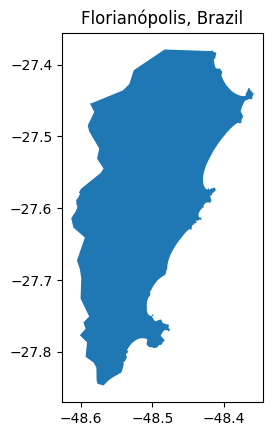

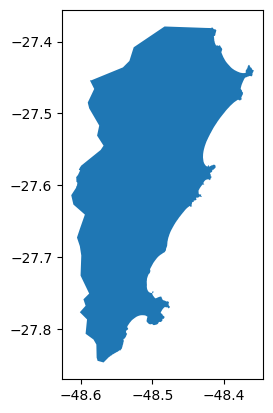

hex num: 6877
poi: school             14
kindergarten        7
language_school     4
Name: poi_type, dtype: int64
[
    {
        "Id": "11f44b484b30c70349e1460821032a8ce1477e75ad6f10994ab3bfb93a1b25bc",
        "Created": "2023-04-06T17:07:50.890479589Z",
        "Path": "osrm-routed",
        "Args": [
            "--algorithm",
            "mld",
            "/data/sul-latest.osm.pbf"
        ],
        "State": {
            "Status": "exited",
            "Running": false,
            "Paused": false,
            "Restarting": false,
            "OOMKilled": false,
            "Dead": false,
            "Pid": 0,
            "ExitCode": 0,
            "Error": "",
            "StartedAt": "2023-04-06T17:13:39.736606791Z",
            "FinishedAt": "2023-04-06T17:14:07.178854913Z"
        },
        "Image": "sha256:6e654e0e06b3b580457ae3bae43474c86f10d46eeb8b1b89899e5714eff19938",
        "ResolvConfPath": "/var/lib/docker/containers/11f44b484b30c70349e1460821032a8ce1477e75ad6f109

  0%|          | 0/6877 [00:00<?, ?it/s]

UID                 PID                 PPID                C                   STIME               TTY                 TIME                CMD
root                18251               18231               18                  17:21               ?                   00:00:08            osrm-routed --algorithm mld /data/sul-latest.osm.pbf
osrm_routing_server_south-america_brazil_sul_foot
Server was stoped succesfully


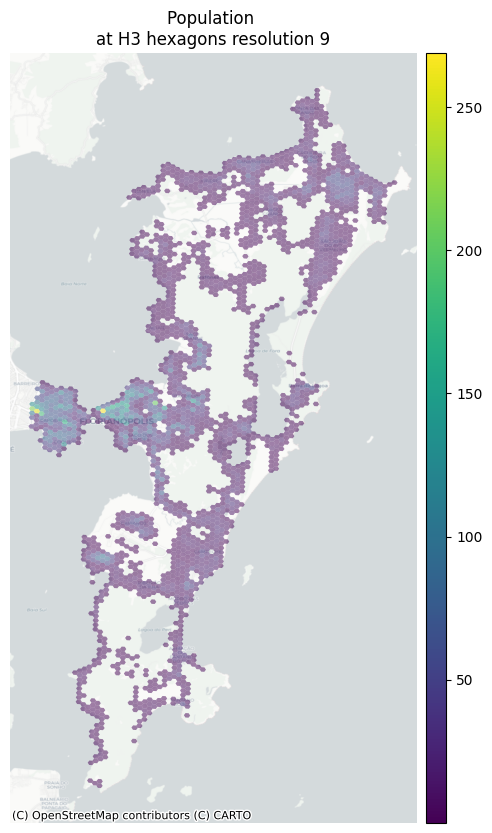

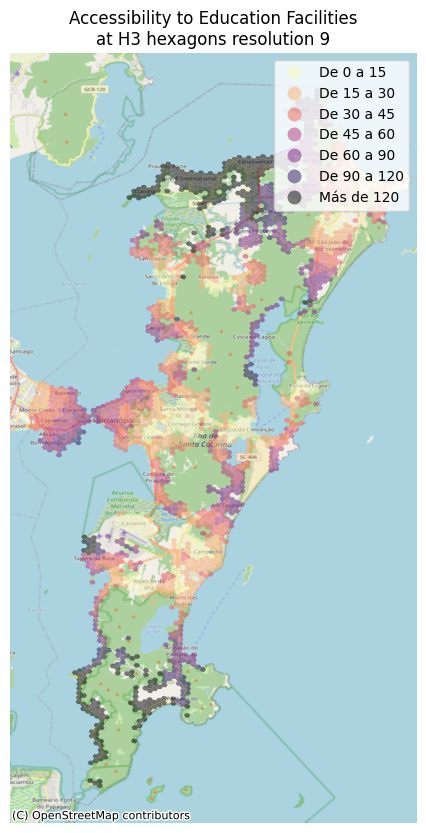

In [25]:
# Specific parameters for Florianopolis
city_str='Florianópolis, Brazil'
hex_res=9
poi_type='education'
osrm_server={"country":"sul", "continent":"south-america_brazil"}

# Locale-specific population
flor = up.download.nominatim_osm(city_str)
flor.plot()
plt.title(city_str)

pop_flor = up.geom.filter_population(full_pop_brazil_southeast, flor)
## multiply every row in pop_flor by 0.07
pop_flor.head()
pop_flor['population'] = pop_flor['population_2020'].parallel_apply(lambda x: x*0.07)


hexs_florianopolis_pop_access = gen_map(city_str, pop_flor, pop_col, hex_res, poi_type, osrm_server)

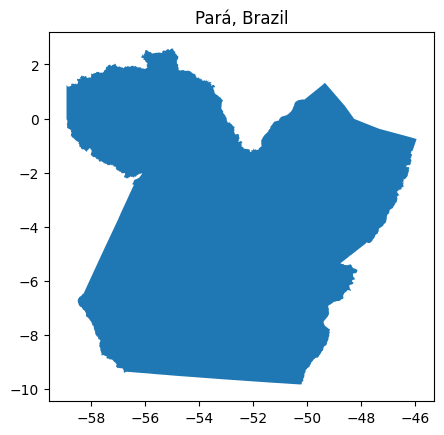

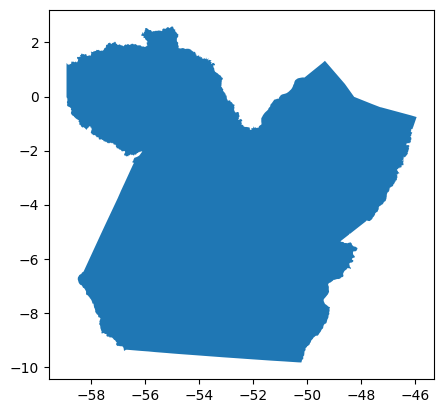

hex num: 31371
poi: school             1954
kindergarten          7
language_school       3
Name: poi_type, dtype: int64
[
    {
        "Id": "11f44b484b30c70349e1460821032a8ce1477e75ad6f10994ab3bfb93a1b25bc",
        "Created": "2023-04-06T17:07:50.890479589Z",
        "Path": "osrm-routed",
        "Args": [
            "--algorithm",
            "mld",
            "/data/sul-latest.osm.pbf"
        ],
        "State": {
            "Status": "exited",
            "Running": false,
            "Paused": false,
            "Restarting": false,
            "OOMKilled": false,
            "Dead": false,
            "Pid": 0,
            "ExitCode": 0,
            "Error": "",
            "StartedAt": "2023-04-06T17:21:35.756842852Z",
            "FinishedAt": "2023-04-06T17:22:24.243423336Z"
        },
        "Image": "sha256:6e654e0e06b3b580457ae3bae43474c86f10d46eeb8b1b89899e5714eff19938",
        "ResolvConfPath": "/var/lib/docker/containers/11f44b484b30c70349e1460821032a8ce1477e75

  0%|          | 0/31371 [00:00<?, ?it/s]

UID                 PID                 PPID                C                   STIME               TTY                 TIME                CMD
root                19472               19451               15                  17:23               ?                   00:00:21            osrm-routed --algorithm mld /data/sul-latest.osm.pbf
osrm_routing_server_south-america_brazil_sul_foot
Server was stoped succesfully


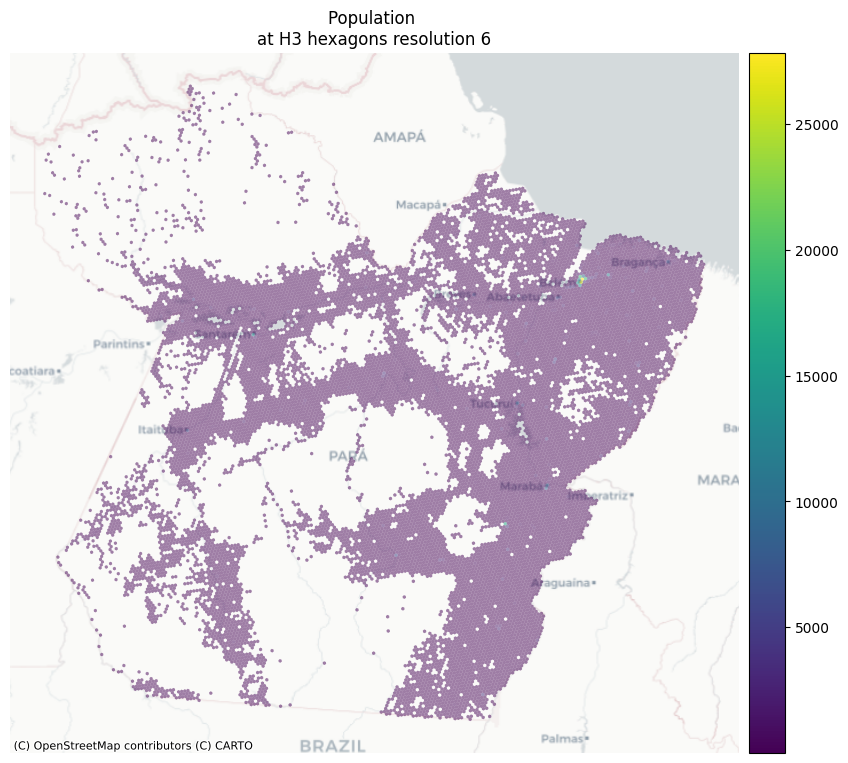

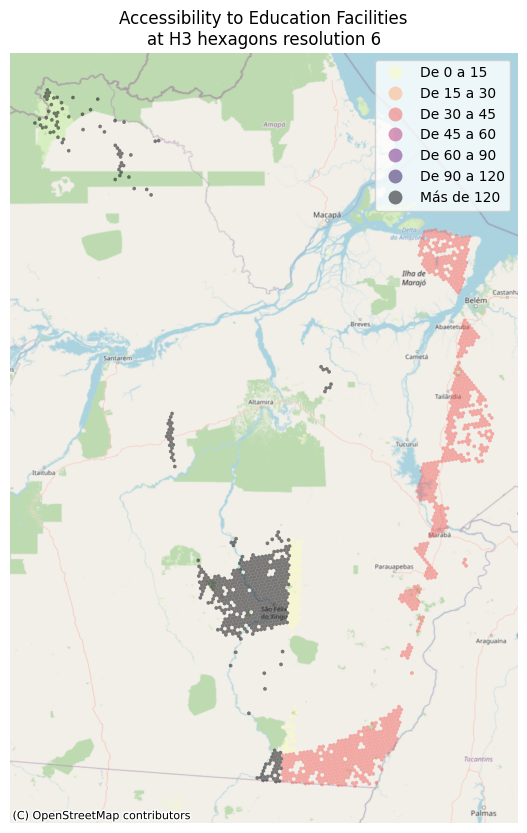

In [26]:
# Specific parameters for Para
city_str='Pará, Brazil'
hex_res=6
poi_type='education'
osrm_server={"country":"sul", "continent":"south-america_brazil"}

# Locale-specific population
para = up.download.nominatim_osm(city_str)
para.plot()
plt.title(city_str)

pop_para_northeast = up.geom.filter_population(full_pop_brazil_northeast, para)
pop_para_northwest = up.geom.filter_population(full_pop_brazil_northwest, para)

pop_para_northeast['population'] = pop_para_northeast['population_2020'].parallel_apply(lambda x: x*0.07)
pop_para_northwest['population'] = pop_para_northwest['population_2020'].parallel_apply(lambda x: x*0.07)


pop_para = pd.concat([pop_para_northeast, pop_para_northwest], ignore_index=True)

hexs_para_pop_access = gen_map(city_str, pop_para, pop_col, hex_res, poi_type, osrm_server)

In [27]:
plotly.offline.init_notebook_mode()

In [28]:
labels = hexs_florianopolis_pop_access['duration_to_nearest_poi_label'].unique().sort_values()

In [29]:
interactive_map(hexs_florianopolis_pop_access, 'Florianopolis', pop_col, labels)

In [30]:
labels = hexs_para_pop_access['duration_to_nearest_poi_label'].unique().sort_values()
interactive_map(hexs_para_pop_access, 'Para', pop_col, labels)

KeyError: 'De 15 a 30'